# Chronic Lymphocytic Leukemia (CLL) dataset
IAU Projekt ZS 2021/2022

Martiš štvrtok 19:00

Kuráň Matej, Mruzek Matúš

dataset 55

----

1. Základný opis dát spolu s ich charakteristikami (5 bodov)

   Pre dosiahnutie plného počtu bodov uveďte:
   -  počet záznamov,
   -  počet atribútov,
   -  ich typy,
   -  pre zvolené významné atribúty ich distribúcie, základné deskriptívne štatistiky a pod.


2. Párová analýza dát (5 bodov)

  - Preskúmajte vzťahy medzi zvolenými dvojicami atribútov.
  - Identifikujte závislostí medzi dvojicami atribútov a závislosti medzi predikovanou premennou a ostatnými premennými.


3. Formulácia a štatistické overenie hypotéz o dátach (2 body)

  - Sformulujte dve hypotézy o dátach v kontexte zadanej predikčnej úlohy. Príkladom je napr. pacienti v zlepšenom stave majú v priemere inú (vyššiu/nižšiu) hodnotu nejakej látky alebo hormónu ako pacienti v nezlepšenom stave.
  - Sformulované hypotézy overte vhodne zvoleným štatistickým testom.


4. Identifikácia problémov v dátach s navrhnutým riešením (3 body)

  - Identifikujte problémy v dátach napr.: nevhodná štruktúra dát, duplicitné záznamy, nejednotné formáty, chýbajúce hodnoty, vychýlené hodnoty. V dátach sa môžu nachádzať aj iné, tu nevymenované problémy.

  - Navrhnuté riešenie prvotne realizujte na dátach. Problém s dátami môžete riešiť iteratívne v každej fáze aj vo všetkých fázach podľa potreby.
  
----

## 1. časť

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
labor = pd.read_csv('055/labor.csv', sep='\t', header=0, index_col=0)
labor.head()

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr
0,2.41434,47.66259,9.16778,9.06523,Y,56.18953,7.72328,77.10021,005-10-1507,8.01767,5.27468,1.0,Tim Jackson,56.94903,9.29432,single,8.69227
1,0.44643,36.09296,6.36529,5.48567,no,67.86284,7.69235,79.07111,886-08-5964,8.12416,7.76872,1.0,Michael Jones,30.36222,9.45606,single,6.40610
2,0.46287,83.91591,5.70281,5.04303,no,59.22675,7.89615,28.35109,536-56-1355,6.71651,5.73040,0.0,Maria Downs,54.24455,8.67153,single,9.25118
3,0.46506,65.22335,6.96113,7.66778,no,53.20236,6.13281,52.78382,303-87-5769,7.37614,6.28627,0.0,Kerri Clements,48.46886,6.56444,widowed,9.04800
4,0.35351,35.39184,4.94897,5.09294,yes,67.21219,5.55122,56.04014,610-52-3918,8.28312,9.69782,0.0,Penny Davis,57.47901,8.02456,nop,6.59900


In [3]:
profiles = pd.read_csv('055/profiles.csv', sep='\t', header=0, index_col=0)
profiles.head()

,blood_group,ssn,name,sex,birthdate,race,address,company,residence
0,O+,777-25-0553,Carla Joseph,F,22 May 1960,White,"21095 Misty Unions\nPamelaburgh, HI 00601",Moore-Gomez,"442 Robert Park\nNew Gerald, NJ 02818"
1,B+,147-57-3969,Justin Hutchinson,M,1970-09-05,White,"5263 Ashley Run\nSouth Ronaldbury, MT 84175",Castaneda LLC,"17822 Anderson Crossing\nMillsfurt, OH 76420"
2,B-,285-57-9782,Michael Davis,M,"02/03/1980, 00:00:00",White,"3540 Arias Prairie\nRandyburgh, CA 01782","Hardin, Shah and Watts","7580 Lynn Parkway\nLake Cynthiaburgh, KS 79966"
3,O-,554-39-9634,Danielle Johnson DDS,F,1907-07-14,White,"82279 Amanda Estate Suite 284\nRiceberg, NC 94919",Ellis Inc,"063 Tonya Estates Suite 741\nNew Andrewmouth, ..."
4,O-,039-90-8959,Diane Ochoa,F,"06/28/1910, 00:00:00",Black,USS Glover\nFPO AA 15009,"Ford, Baker and Adkins","89231 Johnson Walks\nNew Joseph, NH 21932"


In [4]:
merged_data = labor.merge(profiles, on='ssn', how='outer')
merged_data.head()

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,...,relationship,etytr,blood_group,name_y,sex,birthdate,race,address,company,residence
0,2.41434,47.66259,9.16778,9.06523,Y,56.18953,7.72328,77.10021,005-10-1507,8.01767,...,single,8.69227,B-,Tim Jackson,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...
1,0.52600,25.44736,6.39544,5.36393,yes,33.06488,4.59519,54.86711,005-10-1507,8.48561,...,widowed,7.81258,B-,Tim Jackson,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...
2,0.44887,11.49107,6.17123,6.18092,Y,29.36710,6.17309,48.94474,005-10-1507,8.69126,...,single,8.65872,B-,Tim Jackson,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...
3,0.44643,36.09296,6.36529,5.48567,no,67.86284,7.69235,79.07111,886-08-5964,8.12416,...,single,6.40610,A-,Michael Jones,M,"07/16/1981, 00:00:00",White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...
4,0.25791,58.92836,5.54060,5.27504,yes,59.05766,5.62712,37.28702,886-08-5964,7.51701,...,nop,7.04489,A-,Michael Jones,M,"07/16/1981, 00:00:00",White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...


In [12]:
(merged_data.name_x != merged_data.name_y).sum()

0

In [5]:
merged_data = merged_data.drop(columns='name_y').rename(columns={'name_x':'name'})

### 1.1 Počet záznamov:

In [27]:
len(labor.index)

9961


In [28]:
len(profiles.index)

3138


In [33]:
len(merged_data)

9961

### 1.2 Počet atribútov 

In [29]:
len(labor.columns)

17


In [30]:
len(profiles.columns)

9


In [34]:
len(merged_data.columns)

24

### 1.3 Typy atribútov

In [31]:
labor.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9961 entries, 0 to 9960
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   alt           9931 non-null   float64
 1   alp           9930 non-null   float64
 2   erytrocyty    9931 non-null   float64
 3   trombocyty    9931 non-null   float64
 4   smoker        9961 non-null   object 
 5   ast           9931 non-null   float64
 6   leukocyty     9930 non-null   float64
 7   weight        9961 non-null   float64
 8   ssn           9961 non-null   object 
 9   hemoglobin    9931 non-null   float64
 10  hematokrit    9931 non-null   float64
 11  indicator     9961 non-null   float64
 12  name          9961 non-null   object 
 13  er-cv         9931 non-null   float64
 14  hbver         9930 non-null   float64
 15  relationship  9961 non-null   object 
 16  etytr         9930 non-null   float64
dtypes: float64(13), object(4)
memory usage: 1.4+ MB


In [32]:
profiles.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3138 entries, 0 to 3137
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   blood_group  3138 non-null   object
 1   ssn          3138 non-null   object
 2   name         3138 non-null   object
 3   sex          3138 non-null   object
 4   birthdate    3138 non-null   object
 5   race         3138 non-null   object
 6   address      3138 non-null   object
 7   company      3138 non-null   object
 8   residence    3138 non-null   object
dtypes: object(9)
memory usage: 245.2+ KB


In [37]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9961 entries, 0 to 9960
Data columns (total 24 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   alt           9931 non-null   float64
 1   alp           9930 non-null   float64
 2   erytrocyty    9931 non-null   float64
 3   trombocyty    9931 non-null   float64
 4   smoker        9961 non-null   object 
 5   ast           9931 non-null   float64
 6   leukocyty     9930 non-null   float64
 7   weight        9961 non-null   float64
 8   ssn           9961 non-null   object 
 9   hemoglobin    9931 non-null   float64
 10  hematokrit    9931 non-null   float64
 11  indicator     9961 non-null   float64
 12  name          9961 non-null   object 
 13  er-cv         9931 non-null   float64
 14  hbver         9930 non-null   float64
 15  relationship  9961 non-null   object 
 16  etytr         9930 non-null   float64
 17  blood_group   9961 non-null   object 
 18  sex           9961 non-null 

### 1.4 Deskriptívne štatistiky

In [19]:
labor.describe(include='all')

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr
count,9931.000000,9930.000000,9931.000000,9931.000000,9961,9931.000000,9930.000000,9961.000000,9961,9931.000000,9931.000000,9961.000000,9961,9931.000000,9930.000000,9961,9930.000000
unique,NaN,NaN,NaN,NaN,4,NaN,NaN,NaN,3138,NaN,NaN,NaN,3078,NaN,NaN,6,NaN
top,NaN,NaN,NaN,NaN,no,NaN,NaN,NaN,839-51-4689,NaN,NaN,NaN,Melissa Garcia,NaN,NaN,married,NaN
freq,NaN,NaN,NaN,NaN,5489,NaN,NaN,NaN,5,NaN,NaN,NaN,13,NaN,NaN,2570,NaN
mean,1.599338,67.135307,7.637183,6.391385,NaN,50.700209,6.834541,69.697830,NaN,6.851952,6.851529,0.640598,NaN,49.306906,8.078577,NaN,7.644743
std,3.547398,20.698008,1.506321,1.745609,NaN,13.233297,1.006680,35.353764,NaN,0.992378,0.998617,0.479849,NaN,13.511759,1.215946,NaN,1.501712
min,0.000000,0.000000,2.583640,0.293720,NaN,0.000000,2.849550,-73.987940,NaN,2.636480,3.079190,0.000000,NaN,0.000000,2.047440,NaN,0.000000
25%,0.460690,55.741780,6.513030,5.183500,NaN,41.578565,6.160493,45.958540,NaN,6.180330,6.184955,0.000000,NaN,39.998415,7.280980,NaN,6.897400
50%,0.776670,74.352805,7.732810,6.176010,NaN,50.682410,6.835335,69.971170,NaN,6.855240,6.853900,1.000000,NaN,49.597150,8.084565,NaN,7.826715
75%,1.503220,82.940605,8.679175,7.447880,NaN,59.654665,7.518682,93.143610,NaN,7.532580,7.518560,1.000000,NaN,58.313545,8.864550,NaN,8.632370


In [20]:
profiles.describe(include='all')

,blood_group,ssn,name,sex,birthdate,race,address,company,residence
count,3138,3138,3138,3138,3138,3138,3138,3138,3138
unique,8,3138,3078,2,3115,8,3138,2940,3138
top,B+,777-25-0553,Melissa Garcia,F,"03/05/1946, 00:00:00",White,"21095 Misty Unions\nPamelaburgh, HI 00601",White Inc,"442 Robert Park\nNew Gerald, NJ 02818"
freq,409,1,4,1606,2,1512,1,6,1


### Vysvetlivky jednotlivých polí
- **ALT** - [Alanine transaminase](https://en.wikipedia.org/wiki/Alanine_transaminase)
- **ALP** - [Alkaline phosphatase](https://en.wikipedia.org/wiki/Alkaline_phosphatase)
- **erytrocyty** - [červené krvinky](https://en.wikipedia.org/wiki/Red_blood_cell)
- **trombocyty** - [krvné doštičky](https://en.wikipedia.org/wiki/Platelet)
- **smoker** - fajčiar (áno/nie)
- **AST** - [Aspartate transaminase](https://en.wikipedia.org/wiki/Aspartate_transaminase)
- **leukocyty** - [biele krvinky](https://en.wikipedia.org/wiki/White_blood_cell)
- **weight** - váha (pravdepodobne v kg)
- **SSN** - [Social Security number](https://en.wikipedia.org/wiki/Social_Security_number) (niečo ako ID osoby)
- **hemoglobin** - [hemoglobín](https://en.wikipedia.org/wiki/Hemoglobin)
- **hematokrit** - [hematokrit](https://en.wikipedia.org/wiki/Hematocrit) - pomer zväčša červených krviniek k celkovému objemu krvi
- **indicator** - či sa môže predĺžiť interval vyšetrení? (áno/nie)
- **name** - meno
- **er-cv** - ???
- **hbver** - hemoglobín... ??
- **relationship** - vzťah (slobodný, vo vzťahu, rozvedený, ovdovený, oddelený, neuvedené)
- **etytr** - ???
- source: http://www.ousa.sk/_img/Documents/laboratorne_sluzby.pdf

ALT a AST sa zvyknú uvádzať aj ako pomer ([AST/ALT ratio](https://en.wikipedia.org/wiki/AST/ALT_ratio))"

## 4. časť

### 4.1 chýbajúce hodnoty

In [33]:
labor.isnull().sum()

alt             30
alp             31
erytrocyty      30
trombocyty      30
smoker           0
ast             30
leukocyty       31
weight           0
ssn              0
hemoglobin      30
hematokrit      30
indicator        0
name             0
er-cv           30
hbver           31
relationship     0
etytr           31
dtype: int64

In [40]:
labor.isnull().sum(axis=1).value_counts()

0    9632
1     324
2       5
dtype: int64

In [39]:
labor.isnull().any(axis=1).sum() / len(labor)

0.03302881236823612

### 4.2 duplicitné záznamy

In [70]:
s = labor.duplicated()
s = s[s == True]
labor.iloc[s.index]

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr
1456,0.99595,82.62525,7.95654,5.91553,no,54.06467,6.24241,44.64031,026-98-8621,6.68905,7.17969,0.0,Dana Anderson,66.69397,8.37786,divoced,5.91761
1804,0.75184,81.24226,7.68168,6.90437,Y,59.94638,6.15158,130.94053,839-51-4689,5.98691,5.94014,1.0,Randy Pena,59.38507,10.48595,single,6.21683
1961,1.05084,86.99284,8.30352,6.51639,no,49.92154,7.88998,51.77402,772-65-4862,6.71096,6.08963,1.0,Lisa Lynch,57.21401,8.21980,separated,7.47871
2071,1.78604,90.29398,8.86612,7.33741,no,55.06779,6.05863,157.97238,882-37-1793,5.95263,7.03778,1.0,Robert Smith,36.99970,9.22796,divoced,8.06004
2561,1.26566,78.01418,8.52994,8.60777,Y,61.13662,6.33790,87.51879,353-11-7082,5.73645,6.16464,1.0,Lisa Castillo,48.52873,8.51523,nop,8.34057
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9573,0.38668,62.37099,6.89109,6.74317,yes,56.63027,4.90675,20.27659,599-67-7523,7.60943,6.38481,1.0,Mrs. Felicia Ellis DVM,59.88310,7.86593,married,6.59984
9616,0.63760,75.58812,7.41635,10.10553,no,48.32590,6.91855,101.56003,225-31-1394,5.54302,6.41789,1.0,Marie Hill,45.53280,6.64364,single,7.95698
9731,2.24017,82.99376,9.20393,6.05503,no,50.08331,7.54209,123.43539,602-73-1845,6.62429,7.13265,1.0,Steven Ramirez,69.20767,5.22923,married,8.91281
9748,7.50021,59.02216,10.49235,4.27623,yes,50.95897,7.21199,112.74120,658-78-7205,5.11670,4.95148,0.0,Jerome Hawkins,53.03173,6.94077,married,3.05107


In [6]:
labor = labor.drop_duplicates()

### 4.3 nejednotné formáty

In [34]:
merged_data.smoker.value_counts()

no     5489
Y      1983
yes    1959
N       530
Name: smoker, dtype: int64

In [7]:
merged_data['smoker'] = merged_data['smoker'].replace({'yes' : 'Y', 'no' : 'N'})
merged_data.smoker.value_counts()

N    6019
Y    3942
Name: smoker, dtype: int64

In [82]:
merged_data.indicator.nunique()

2

### 4.4 vychýlené hodnoty

<AxesSubplot:xlabel='trombocyty'>

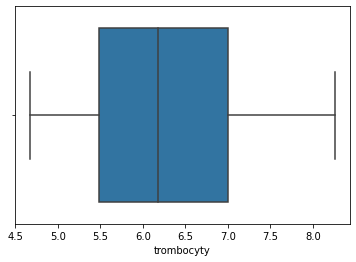

In [53]:
sns.boxplot(x=labor['trombocyty'])

<AxesSubplot:xlabel='weight'>

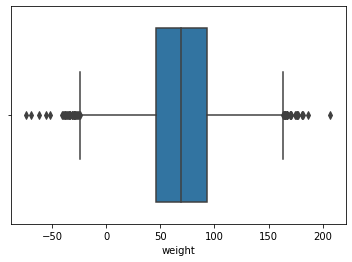

In [52]:
labor = labor[labor['trombocyty'].between(labor['trombocyty'].quantile(.15), labor['trombocyty'].quantile(.85))] 

<AxesSubplot:xlabel='trombocyty', ylabel='Count'>

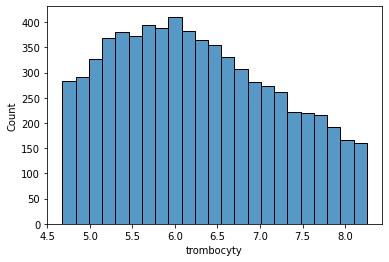

In [54]:
sns.histplot(labor['trombocyty'])

In [42]:
labor.weight[labor.weight < 0]

11     -15.26563
61      -5.36972
103    -20.14341
134    -22.24133
152     -1.84678
          ...   
9588   -10.42069
9649   -31.71885
9665   -21.95376
9758   -10.03687
9843   -23.53985
Name: weight, Length: 249, dtype: float64

In [47]:
labor.loc[labor.weight < 0, 'weight'] = np.nan

In [52]:
labor.weight.isnull().sum()

249

## 2. časť

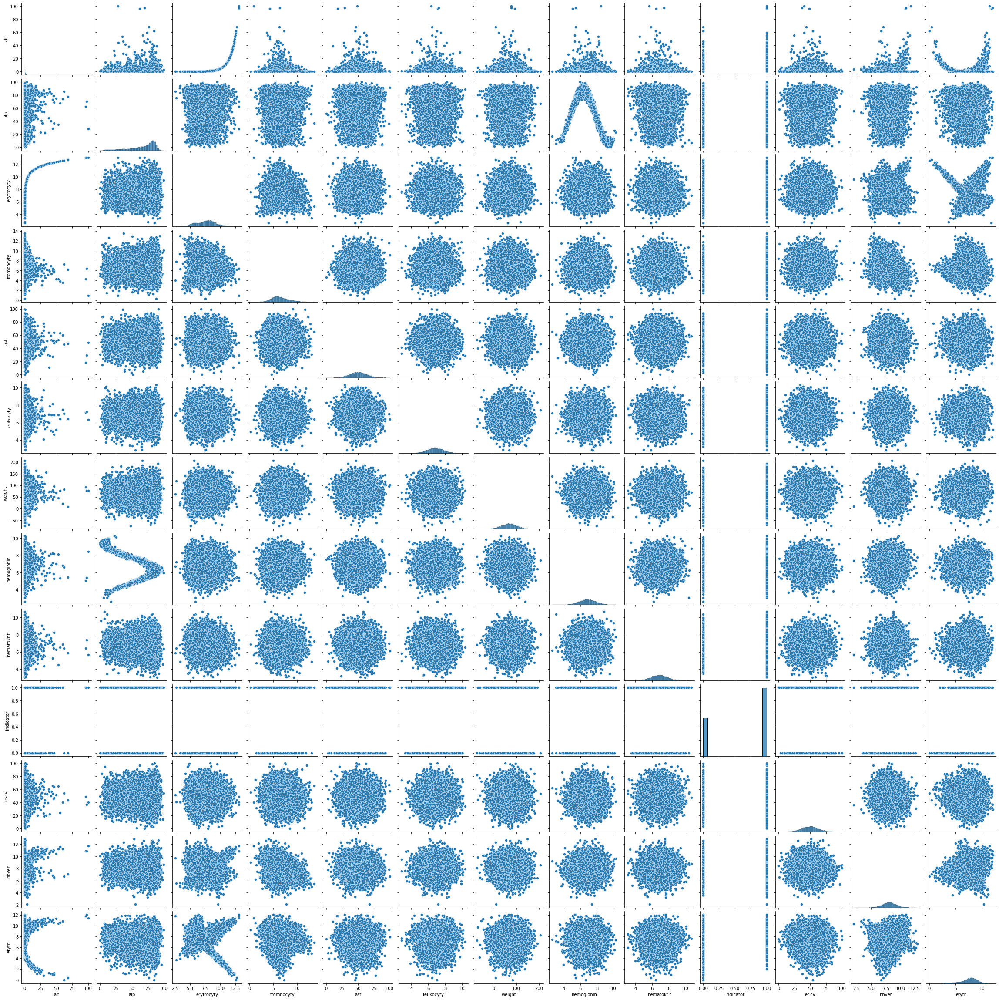

In [75]:
sns.pairplot(labor)

<AxesSubplot:xlabel='erytrocyty', ylabel='alt'>

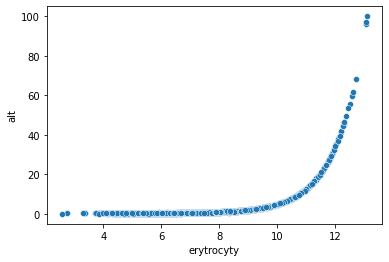

In [54]:
sns.scatterplot(data=merged_data, x='erytrocyty', y='alt')

<AxesSubplot:>

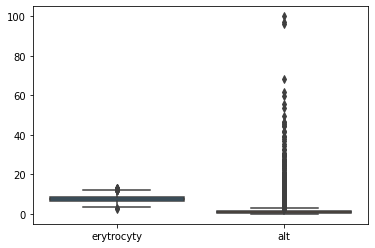

In [74]:
sns.boxplot(data=labor.loc[:,['erytrocyty', 'alt']])

<AxesSubplot:xlabel='alt'>

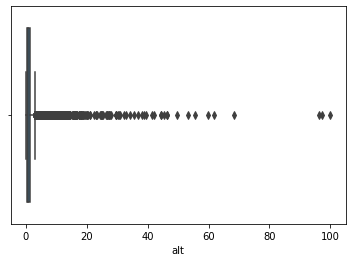

In [59]:
sns.boxplot(data=labor, x='alt')

<AxesSubplot:xlabel='alt', ylabel='Count'>

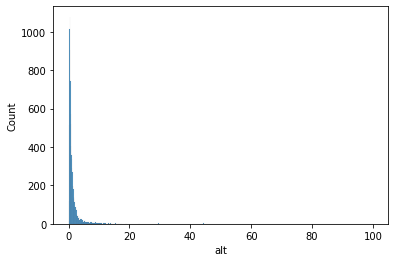

In [60]:
sns.histplot(labor['alt'])

<AxesSubplot:xlabel='alp', ylabel='hemoglobin'>

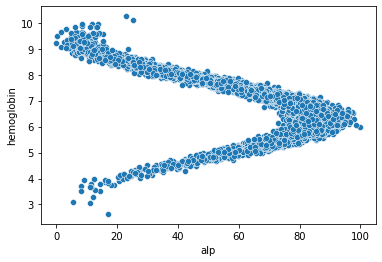

In [77]:
sns.scatterplot(data=merged_data, x='alp', y='hemoglobin')

<AxesSubplot:xlabel='erytrocyty', ylabel='etytr'>

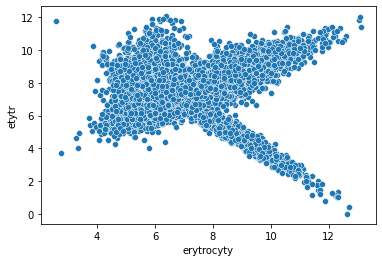

In [78]:
sns.scatterplot(data=merged_data, x='erytrocyty', y='etytr')

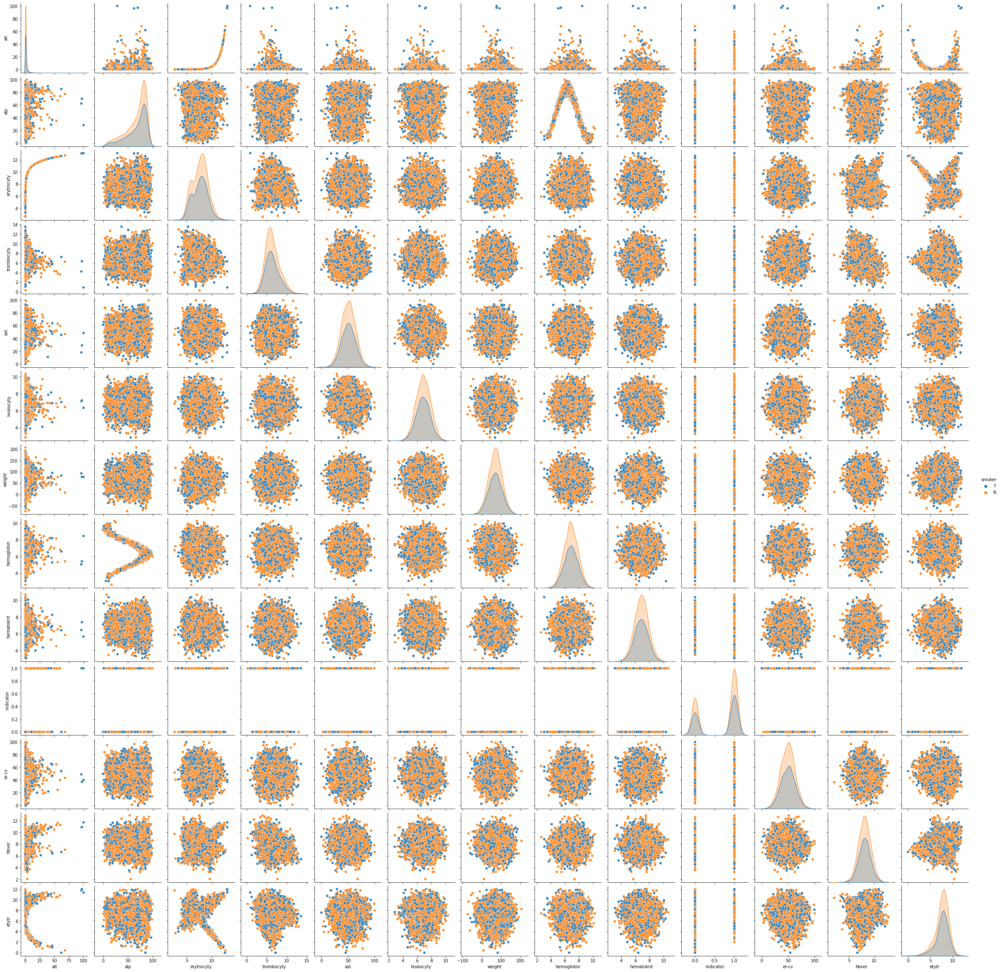

In [83]:
sns.pairplot(merged_data, hue='smoker')

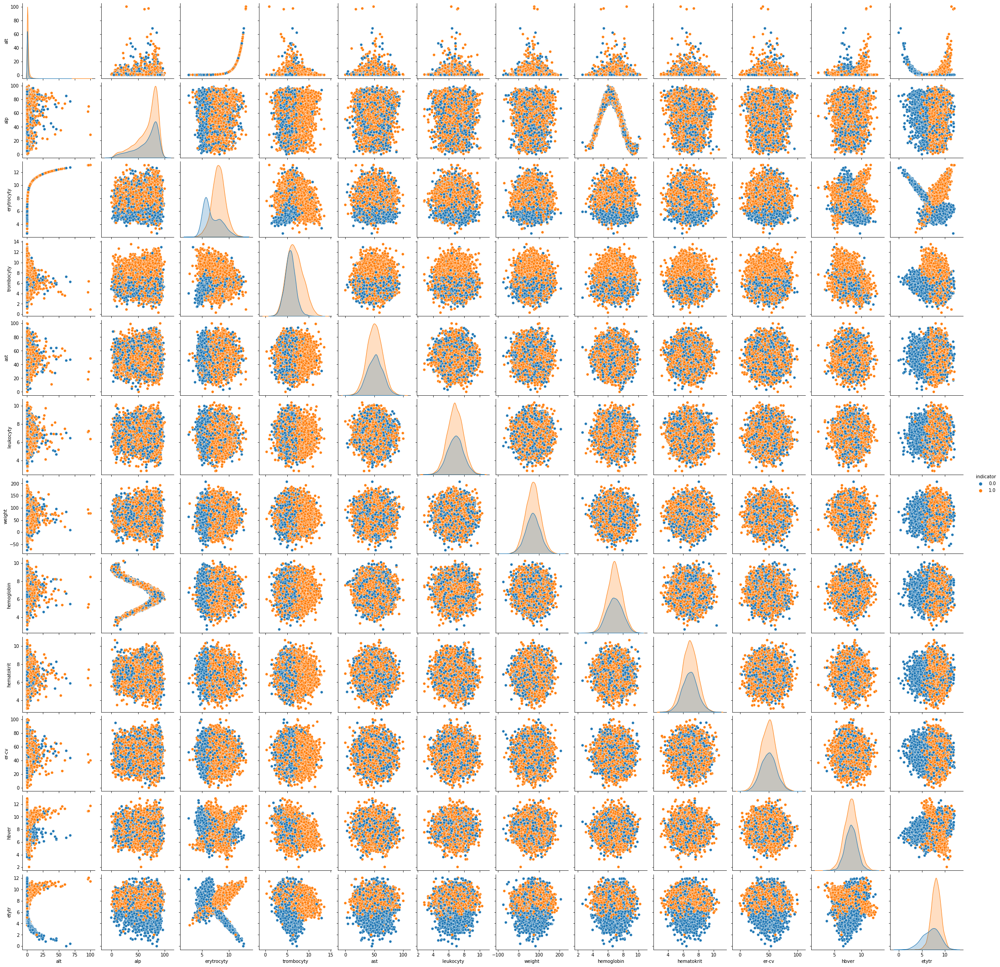

In [84]:
sns.pairplot(merged_data, hue='indicator')

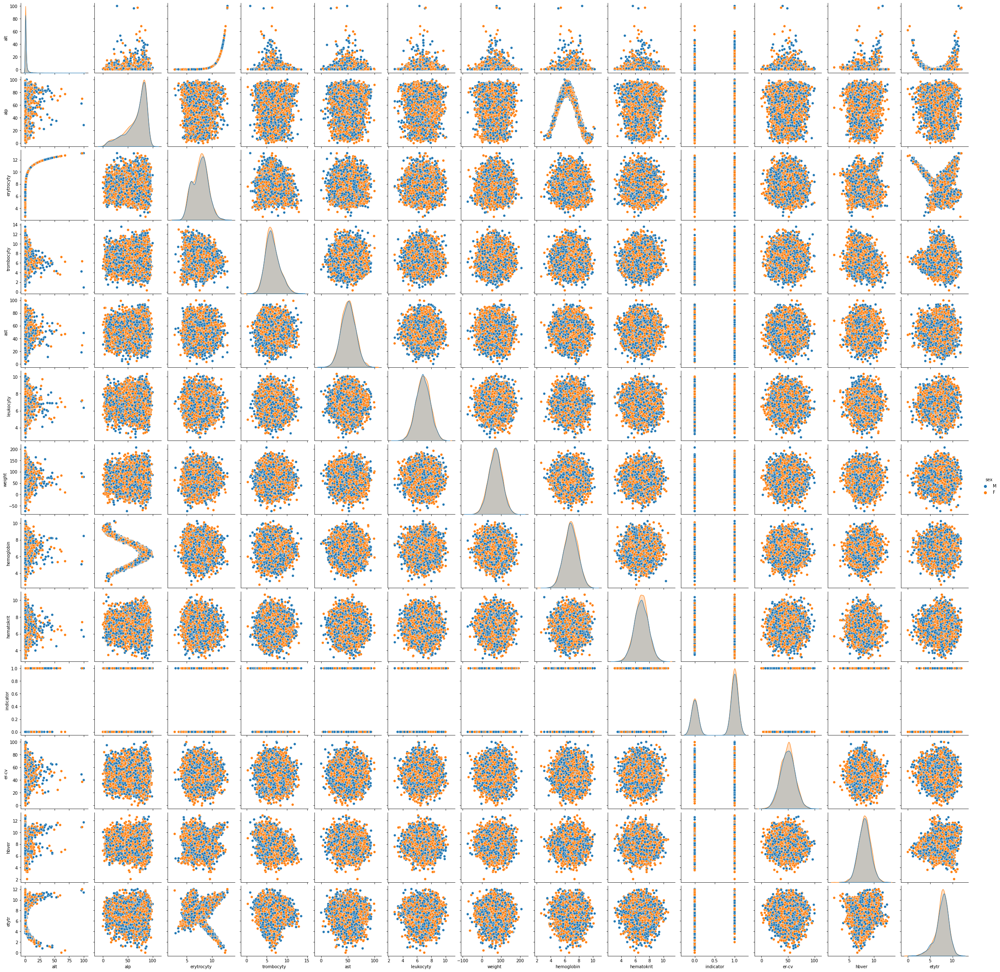

In [88]:
sns.pairplot(merged_data, hue='sex')

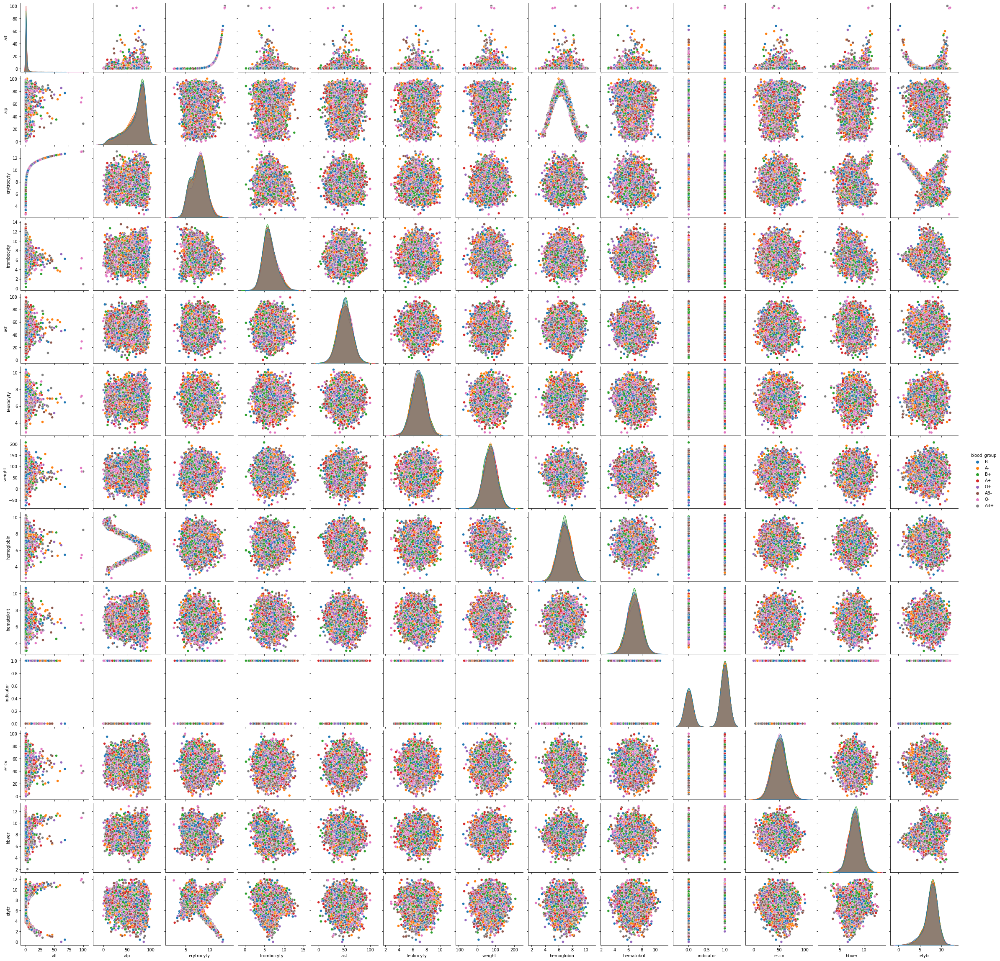

In [10]:
sns.pairplot(merged_data, hue='blood_group')

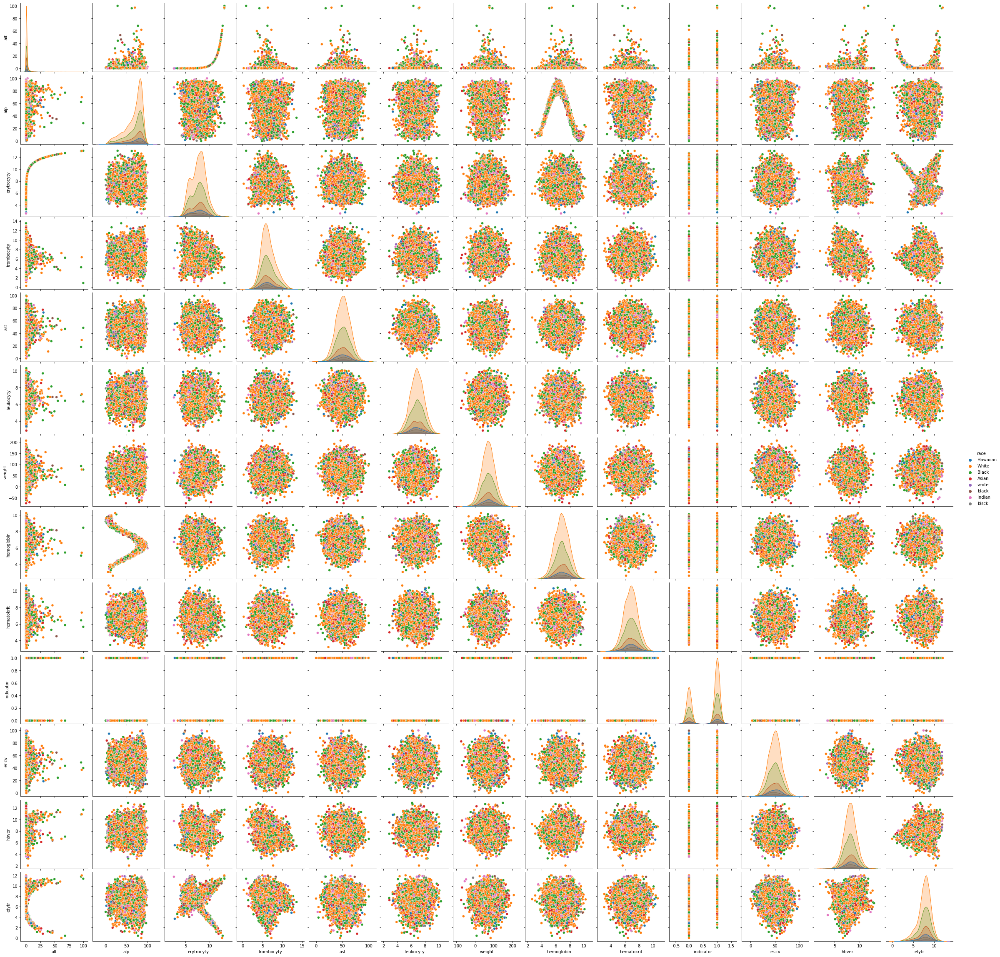

In [11]:
sns.pairplot(merged_data, hue='race')